# WeatherPy

---

## Starter Code to Generate Random Geographic Coordinates and a List of Cities

In [1]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import time
from scipy.stats import linregress

# Impor the OpenWeatherMap API key
from api_keys import weather_api_key

# Import citipy to determine the cities based on latitude and longitude
from citipy import citipy

pip install citipy

### Generate the Cities List by Using the `citipy` Library

In [2]:
# Empty list for holding the latitude and longitude combinations
lat_lngs = []

# Empty list for holding the cities names
cities = []

# Range of latitudes and longitudes
lat_range = (-90, 90)
lng_range = (-180, 180)

# Create a set of random lat and lng combinations
lats = np.random.uniform(lat_range[0], lat_range[1], size=1500)
lngs = np.random.uniform(lng_range[0], lng_range[1], size=1500)
lat_lngs = zip(lats, lngs)

# Identify nearest city for each lat, lng combination
for lat_lng in lat_lngs:
    city = citipy.nearest_city(lat_lng[0], lat_lng[1]).city_name
    
    # If the city is unique, then add it to a our cities list
    if city not in cities:
        cities.append(city)

# Print the city count to confirm sufficient count
print(f"Number of cities in the list: {len(cities)}")

Number of cities in the list: 618


---

## Requirement 1: Create Plots to Showcase the Relationship Between Weather Variables and Latitude

### Use the OpenWeatherMap API to retrieve weather data from the cities list generated in the started code

{'coord': {'lon': -51.8103, 'lat': -16.9567}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 25.29, 'feels_like': 25.36, 'temp_min': 25.29, 'temp_max': 25.29, 'pressure': 1012, 'humidity': 57, 'sea_level': 1012, 'grnd_level': 934}, 'visibility': 10000, 'wind': {'speed': 1.25, 'deg': 204, 'gust': 1.32}, 'clouds': {'all': 71}, 'dt': 1697932801, 'sys': {'country': 'BR', 'sunrise': 1697878505, 'sunset': 1697923705}, 'timezone': -10800, 'id': 3468234, 'name': 'Caiapônia', 'cod': 200}

In [3]:
# Set the API base URL

api_key = '55fd9f09c162a589ee26dc37ca266b12'
url = "http://api.openweathermap.org/data/2.5/weather?"
units = "metric"

# Build partial query URL
query_url = f"{url}appid={api_key}&units={units}&q="

# Define an empty list to fetch the weather data for each city
city_data = []

# Print to logger
print("Beginning Data Retrieval     ")
print("-----------------------------")

# Create counters
record_count = 1
set_count = 1

# Loop through all the cities in our list to fetch weather data
for i, city in enumerate(cities):
    #print(city)
        
    # Group cities in sets of 50 for logging purposes
    if (i % 50 == 0 and i >= 50):
        set_count += 1
        record_count = 0

    # Create endpoint URL with each city
    #response = requests.get(query_url + city).json()
    
    # Log the url, record, and set numbers
    #print(response)
    print("Processing Record %s of Set %s | %s" % (record_count, set_count, city))

    # Add 1 to the record count
    record_count += 1

    # Run an API request for each of the cities
    try:
        # Parse the JSON and retrieve data
        city_weather  = requests.get(query_url + city).json()

        # Parse out latitude, longitude, max temp, humidity, cloudiness, wind speed, country, and date
        city_lat      = city_weather['coord']['lat']
        city_lng      = city_weather['coord']['lon']
        city_max_temp = city_weather['main']['temp_max']
        city_humidity = city_weather['main']['humidity']
        city_clouds   = city_weather['clouds']['all']
        city_wind     = city_weather['wind']['speed']
        city_country  = city_weather['sys']['country']
        city_date     = city_weather['dt']

        # Append the City information into city_data list
        city_data.append({"City": city, 
                          "Lat": city_lat, 
                          "Lng": city_lng, 
                          "Max Temp": city_max_temp,
                          "Humidity": city_humidity,
                          "Cloudiness": city_clouds,
                          "Wind Speed": city_wind,
                          "Country": city_country,
                          "Date": city_date})
        
        print(city_data)

    # If an error is experienced, skip the city
    except:
        print("City not found. Skipping...")
        pass
              
# Indicate that Data Loading is complete 
print("-----------------------------")
print("Data Retrieval Complete      ")
print("-----------------------------")

Beginning Data Retrieval     
-----------------------------
Processing Record 1 of Set 1 | uturoa
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}]
Processing Record 2 of Set 1 | abu jibeha
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}]
Processing Record 3 of Set 1 | alpine
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 4 of Set 2 | maceio
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidit

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 9 of Set 2 | fale old settlement
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 12 of Set 2 | awjilah
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humid

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 30 of Set 2 | lihue
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidit

City not found. Skipping...
Processing Record 32 of Set 2 | coari
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidit

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 46 of Set 2 | chiili
City not found. Skipping...
Processing Record 47 of Set 2 | portland
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seve

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 1 of Set 3 | la ronge
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humid

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 7 of Set 3 | port alfred
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hu

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 15 of Set 3 | aasiaat
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humid

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 12 of Set 4 | alotau
City not found. Skipping...
Processing Record 13 of Set 4 | najran
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven 

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 24 of Set 4 | ola
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity'

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 33 of Set 4 | tazacorte
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hum

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 36 of Set 4 | viqueque
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humi

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 31 of Set 5 | altai
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidit

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 2 of Set 6 | hong kong
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humi

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 35 of Set 6 | seogwipo
City not found. Skipping...
Processing Record 36 of Set 6 | minas de marcona
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh o

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 16 of Set 7 | champerico
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hu

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 25 of Set 7 | midvagur
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humi

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 43 of Set 7 | itoman
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidi

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 33 of Set 8 | carutapera
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hu

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 41 of Set 8 | ocean shores
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, '

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 44 of Set 8 | kone
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 15 of Set 9 | qarauyl
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humid

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 25 of Set 9 | el granada
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hu

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 30 of Set 9 | san jose village
City not found. Skipping...
Processing Record 31 of Set 9 | buchanan
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh o

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 39 of Set 9 | port mathurin
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 26 of Set 10 | afaahiti
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hum

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 19 of Set 11 | grafton
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humi

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 26 of Set 11 | praia da vitoria
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 30 of Set 11 | ilhabela
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Hum

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 3 of Set 12 | tuymazy
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humid

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 24 of Set 12 | kolonia town
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

City not found. Skipping...
Processing Record 5 of Set 13 | bol'shoye boldino
[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

[{'City': 'uturoa', 'Lat': -16.7333, 'Lng': -151.4333, 'Max Temp': 26.38, 'Humidity': 79, 'Cloudiness': 4, 'Wind Speed': 3.96, 'Country': 'PF', 'Date': 1697934853}, {'City': 'abu jibeha', 'Lat': 11.4562, 'Lng': 31.2285, 'Max Temp': 24.66, 'Humidity': 74, 'Cloudiness': 1, 'Wind Speed': 1.73, 'Country': 'SD', 'Date': 1697934853}, {'City': 'alpine', 'Lat': 32.835, 'Lng': -116.7664, 'Max Temp': 26.64, 'Humidity': 51, 'Cloudiness': 0, 'Wind Speed': 5.14, 'Country': 'US', 'Date': 1697934853}, {'City': 'ilulissat', 'Lat': 69.2167, 'Lng': -51.1, 'Max Temp': -2.99, 'Humidity': 63, 'Cloudiness': 20, 'Wind Speed': 5.14, 'Country': 'GL', 'Date': 1697934854}, {'City': 'formosa do rio preto', 'Lat': -11.0483, 'Lng': -45.1931, 'Max Temp': 28.23, 'Humidity': 40, 'Cloudiness': 40, 'Wind Speed': 1.03, 'Country': 'BR', 'Date': 1697934854}, {'City': 'edinburgh of the seven seas', 'Lat': -37.0676, 'Lng': -12.3116, 'Max Temp': 13.79, 'Humidity': 91, 'Cloudiness': 16, 'Wind Speed': 10.4, 'Country': 'SH', 'Da

In [23]:
city_data

[]

In [4]:
# Convert the cities weather data into a Pandas DataFrame
city_data_df = pd.DataFrame(city_data)

# Show Record Count
city_data_df.count()

City          580
Lat           580
Lng           580
Max Temp      580
Humidity      580
Cloudiness    580
Wind Speed    580
Country       580
Date          580
dtype: int64

In [5]:
# Display sample data
city_data_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,uturoa,-16.7333,-151.4333,26.38,79,4,3.96,PF,1697934853
1,abu jibeha,11.4562,31.2285,24.66,74,1,1.73,SD,1697934853
2,alpine,32.8350,-116.7664,26.64,51,0,5.14,US,1697934853
3,ilulissat,69.2167,-51.1000,-2.99,63,20,5.14,GL,1697934854
4,formosa do rio preto,-11.0483,-45.1931,28.23,40,40,1.03,BR,1697934854


In [8]:
ls


VacationPy.ipynb  __pycache__/      cities.csv
WeatherPy.ipynb   api_keys.py       output/


In [9]:
# Export the City_Data into a csv
city_data_df.to_csv("output/cities.csv", index_label="City_ID")

In [10]:
# Read saved data
city_data_df = pd.read_csv("output/cities.csv", index_col="City_ID")

# Display sample data
city_data_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
City_ID,,,,,,,,,
0,uturoa,-16.7333,-151.4333,26.38,79,4,3.96,PF,1697934853
1,abu jibeha,11.4562,31.2285,24.66,74,1,1.73,SD,1697934853
2,alpine,32.8350,-116.7664,26.64,51,0,5.14,US,1697934853
3,ilulissat,69.2167,-51.1000,-2.99,63,20,5.14,GL,1697934854
4,formosa do rio preto,-11.0483,-45.1931,28.23,40,40,1.03,BR,1697934854


### Create the Scatter Plots Requested

#### Latitude Vs. Temperature

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


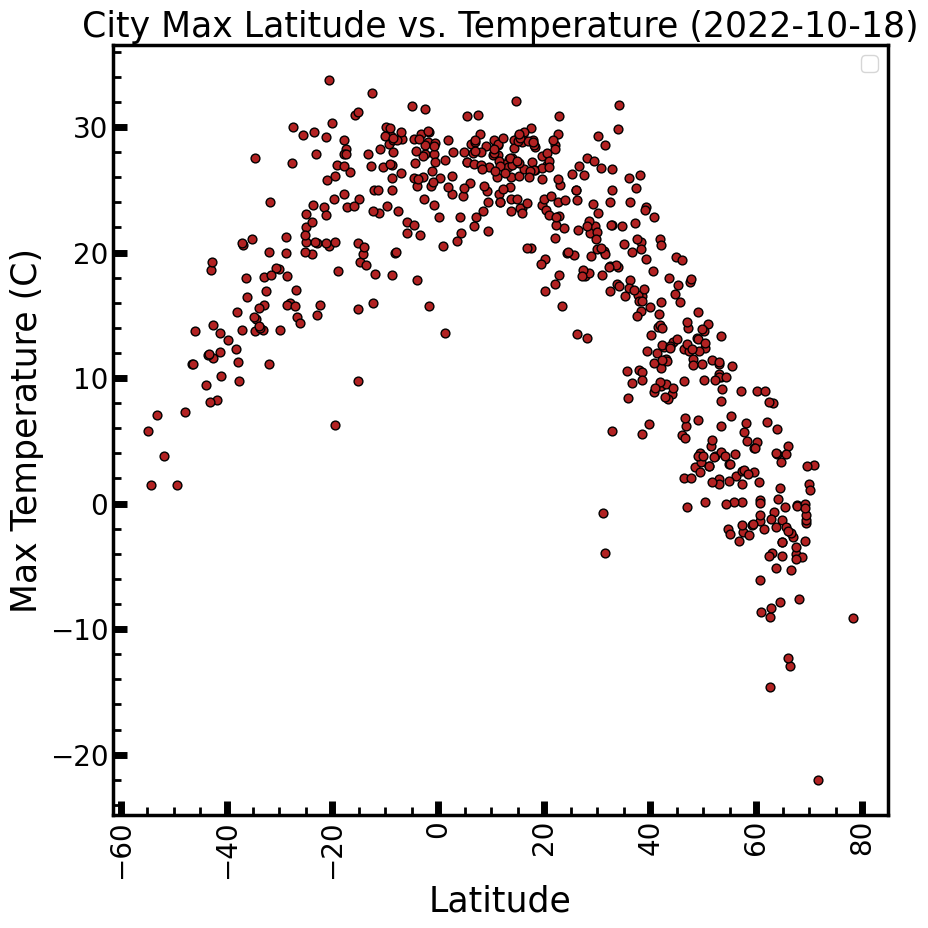

In [34]:
# Create a figure object
fig = plt.figure(figsize=(10,10))
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 2.50

# Create the plot
plt.scatter(city_data_df["Lat"], city_data_df["Max Temp"], marker='o', s=40, color='firebrick', edgecolor='k')
#plt.plot(city_data_df["Lat"], city_data_df["Max Temp"], marker='.', markersize=16, color='firebrick', linestyle="none")
plt.title('City Max Latitude vs. Temperature (2022-10-18)',fontsize=25)
plt.xlabel('Latitude', fontsize=25)
plt.ylabel('Max Temperature (C)', fontsize=25)

plt.minorticks_on() 
plt.tick_params(which='major', length=10, width=5.0, direction='in', labelsize=20, labelcolor='k')
plt.tick_params(which='minor', length=6, width=2.0, direction='in')
#plt.ylim(-5,50)
#plt.xlim(37.5,46)
plt.xticks(rotation=90)

# Show the plot
plt.legend(loc="upper right", fontsize=15)
#plt.tight_layout()
plt.savefig("output/Fig1.png")
plt.show()

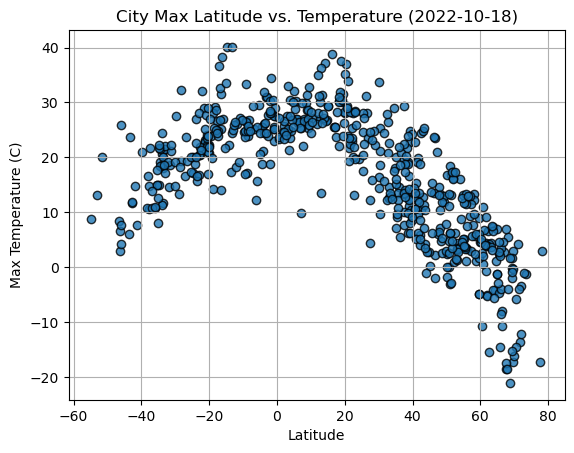

In [8]:
# Build scatter plot for latitude vs. temperature
# YOUR CODE HERE

# Incorporate the other graph properties
# YOUR CODE HERE

# Save the figure
plt.savefig("output_data/Fig1.png")

# Show plo
plt.show()

#### Latitude Vs. Humidity

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


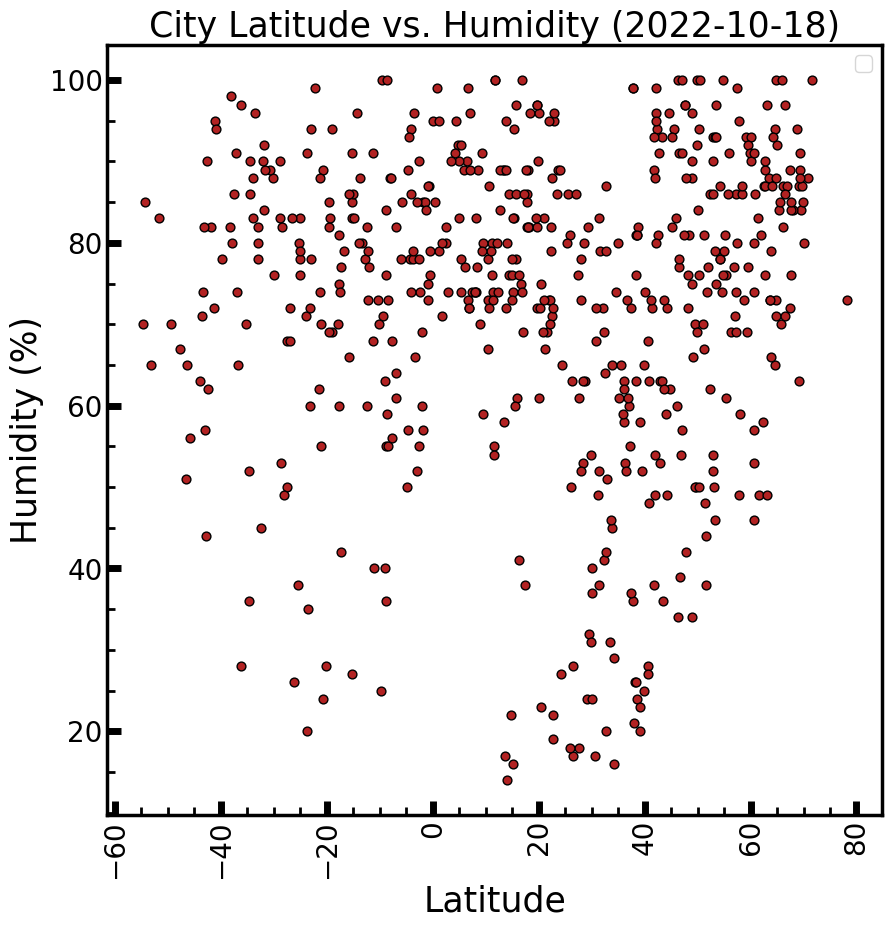

In [36]:
# Create a figure object
fig = plt.figure(figsize=(10,10))
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 2.50

# Create the plot
plt.scatter(city_data_df["Lat"], city_data_df["Humidity"], marker='o', s=40, color='firebrick', edgecolor='k')
#plt.plot(city_data_df["Lat"], city_data_df["Max Temp"], marker='.', markersize=16, color='firebrick', linestyle="none")
plt.title('City Latitude vs. Humidity (2022-10-18)',fontsize=25)
plt.xlabel('Latitude', fontsize=25)
plt.ylabel('Humidity (%)', fontsize=25)

plt.minorticks_on() 
plt.tick_params(which='major', length=10, width=5.0, direction='in', labelsize=20, labelcolor='k')
plt.tick_params(which='minor', length=6, width=2.0, direction='in')
#plt.ylim(-5,50)
#plt.xlim(37.5,46)
plt.xticks(rotation=90)

# Show the plot
plt.legend(loc="upper right", fontsize=15)
#plt.tight_layout()
plt.savefig("output/Fig2.png")
plt.show()

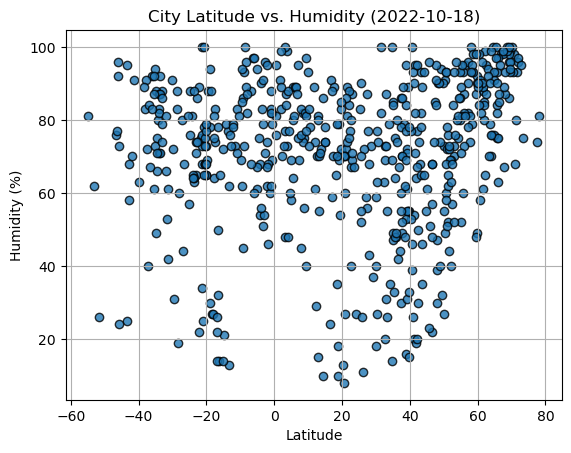

In [9]:
# Build the scatter plots for latitude vs. humidity
# YOUR CODE HERE

# Incorporate the other graph properties
# YOUR CODE HERE

# Save the figure
plt.savefig("output_data/Fig2.png")

# Show plot
plt.show()

#### Latitude Vs. Cloudiness

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


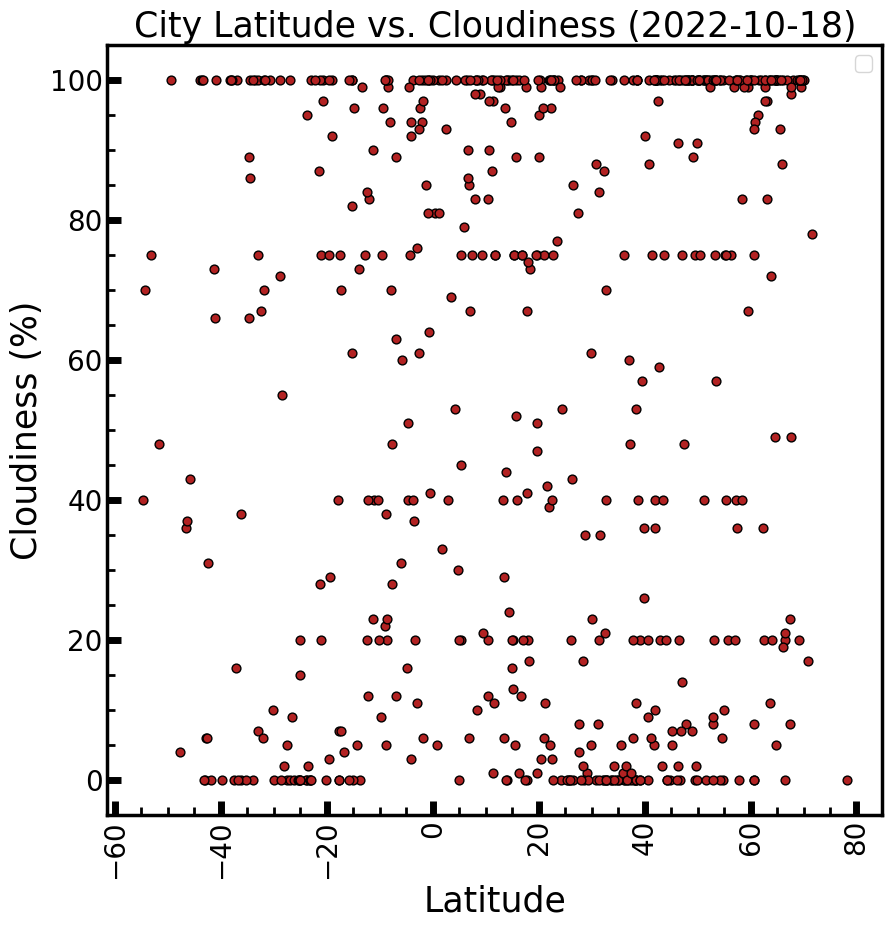

In [38]:
# Create a figure object
fig = plt.figure(figsize=(10,10))
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 2.50

# Create the plot
plt.scatter(city_data_df["Lat"], city_data_df["Cloudiness"], marker='o', s=40, color='firebrick', edgecolor='k')
#plt.plot(city_data_df["Lat"], city_data_df["Max Temp"], marker='.', markersize=16, color='firebrick', linestyle="none")
plt.title('City Latitude vs. Cloudiness (2022-10-18)',fontsize=25)
plt.xlabel('Latitude', fontsize=25)
plt.ylabel('Cloudiness (%)', fontsize=25)

plt.minorticks_on() 
plt.tick_params(which='major', length=10, width=5.0, direction='in', labelsize=20, labelcolor='k')
plt.tick_params(which='minor', length=6, width=2.0, direction='in')
#plt.ylim(-5,50)
#plt.xlim(37.5,46)
plt.xticks(rotation=90)

# Show the plot
plt.legend(loc="upper right", fontsize=15)
#plt.tight_layout()
plt.savefig("output/Fig3.png")
plt.show()

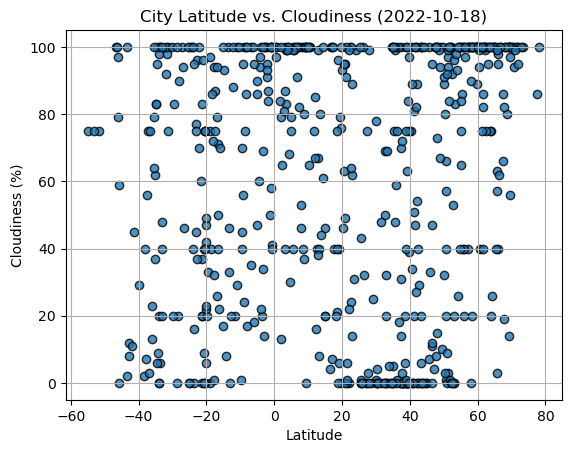

In [10]:
# Build the scatter plots for latitude vs. cloudiness
# YOUR CODE HERE

# Incorporate the other graph properties
# YOUR CODE HERE

# Save the figure
plt.savefig("output_data/Fig3.png")

# Show plot
plt.show()

#### Latitude vs. Wind Speed Plot

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


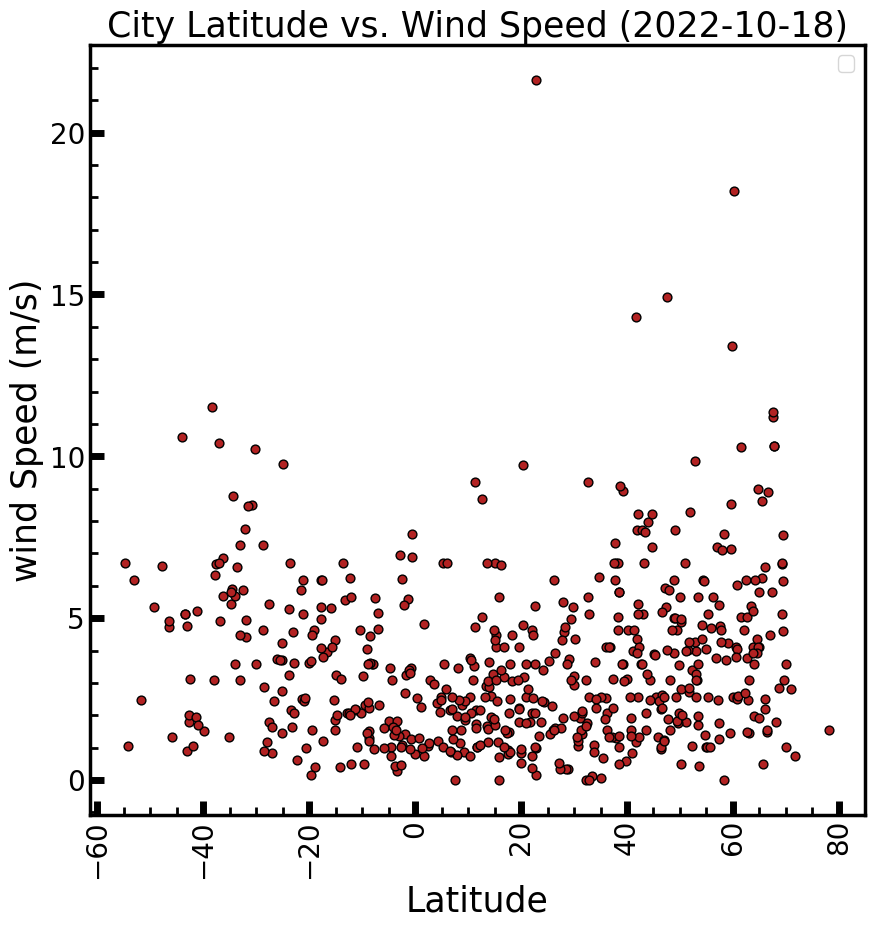

In [40]:
# Create a figure object
fig = plt.figure(figsize=(10,10))
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 2.50

# Create the plot
plt.scatter(city_data_df["Lat"], city_data_df["Wind Speed"], marker='o', s=40, color='firebrick', edgecolor='k')
#plt.plot(city_data_df["Lat"], city_data_df["Max Temp"], marker='.', markersize=16, color='firebrick', linestyle="none")
plt.title('City Latitude vs. Wind Speed (2022-10-18)',fontsize=25)
plt.xlabel('Latitude', fontsize=25)
plt.ylabel('wind Speed (m/s)', fontsize=25)

plt.minorticks_on() 
plt.tick_params(which='major', length=10, width=5.0, direction='in', labelsize=20, labelcolor='k')
plt.tick_params(which='minor', length=6, width=2.0, direction='in')
#plt.ylim(-5,50)
#plt.xlim(37.5,46)
plt.xticks(rotation=90)

# Show the plot
plt.legend(loc="upper right", fontsize=15)
#plt.tight_layout()
plt.savefig("output/Fig4.png")
plt.show()

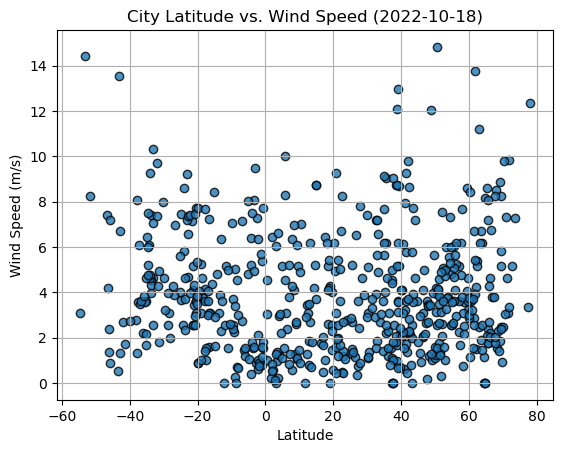

In [11]:
# Build the scatter plots for latitude vs. wind speed
# YOUR CODE HERE

# Incorporate the other graph properties
# YOUR CODE HERE

# Save the figure
plt.savefig("output_data/Fig4.png")

# Show plot
plt.show()

---

## Requirement 2: Compute Linear Regression for Each Relationship


In [12]:
# Define a function to create Linear Regression plots
# YOUR CODE HERE

In [42]:
northern_hemi_df = city_data_df[(city_data_df['Lat'] > 0)]
northern_hemi_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
City_ID,,,,,,,,,
1,abu jibeha,11.4562,31.2285,24.66,74,1,1.73,SD,1697934853
2,alpine,32.8350,-116.7664,26.64,51,0,5.14,US,1697934853
3,ilulissat,69.2167,-51.1000,-2.99,63,20,5.14,GL,1697934854
6,mokhsogollokh,61.4681,128.9203,-2.06,83,95,5.05,RU,1697934855
9,chernyshevskiy,63.0128,112.4714,-3.97,97,97,1.45,RU,1697934856


In [13]:
# Create a DataFrame with the Northern Hemisphere data (Latitude >= 0)
# YOUR CODE HERE

# Display sample data
northern_hemi_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
City_ID,,,,,,,,,
0,faya,18.3851,42.4509,22.06,35,21,2.60,SA,1666108228
1,farsund,58.0948,6.8047,13.30,100,0,7.65,NO,1666108228
3,jamestown,42.0970,-79.2353,5.77,77,100,9.77,US,1666107934
4,lanzhou,36.0564,103.7922,14.53,48,59,1.20,CN,1666108230
6,albany,42.6001,-73.9662,10.36,74,29,2.10,US,1666108231


In [43]:
southern_hemi_df = city_data_df[(city_data_df['Lat'] < 0)]
southern_hemi_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
City_ID,,,,,,,,,
0,uturoa,-16.7333,-151.4333,26.38,79,4,3.96,PF,1697934853
4,formosa do rio preto,-11.0483,-45.1931,28.23,40,40,1.03,BR,1697934854
5,edinburgh of the seven seas,-37.0676,-12.3116,13.79,91,16,10.40,SH,1697934854
7,waitangi,-43.9535,-176.5597,9.42,63,100,10.61,NZ,1697934855
8,papatowai,-46.5619,169.4708,11.09,51,36,4.74,NZ,1697934856


In [14]:
# Create a DataFrame with the Southern Hemisphere data (Latitude < 0)
# YOUR CODE HERE

# Display sample data
southern_hemi_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
City_ID,,,,,,,,,
2,new norfolk,-42.7826,147.0587,11.72,58,12,1.34,AU,1666108230
5,ushuaia,-54.8000,-68.3000,8.81,81,75,3.09,AR,1666108231
7,carnarvon,-24.8667,113.6333,20.02,76,0,7.46,AU,1666108232
9,saint-pierre,-21.3393,55.4781,22.82,68,0,5.14,RE,1666108236
10,colorado,-22.8375,-51.9731,20.36,86,96,4.69,BR,1666107965


###  Temperature vs. Latitude Linear Regression Plot

The r-value is: 0.7161472181434118


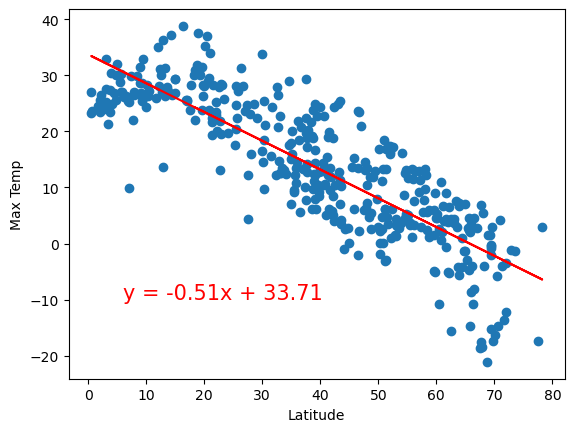

In [15]:
# Linear regression on Northern Hemisphere
# YOUR CODE HERE

The r-value is: 0.4121057168607245


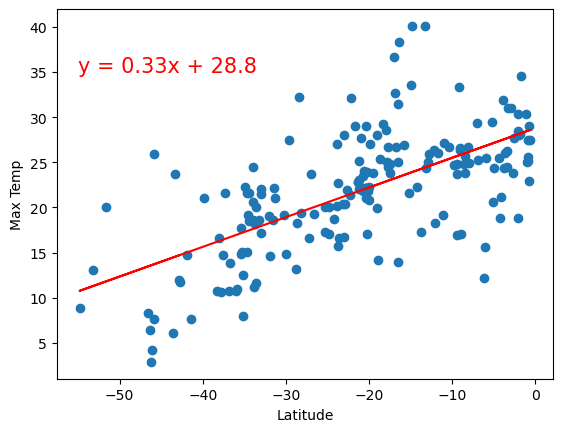

In [16]:
# Linear regression on Southern Hemisphere
# YOUR CODE HERE

**Discussion about the linear relationship:** YOUR RESPONSE HERE

### Humidity vs. Latitude Linear Regression Plot

The r-value is: 0.05689741545789598


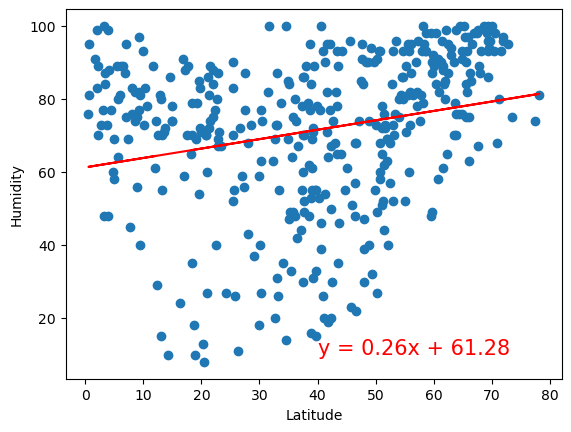

In [17]:
# Northern Hemisphere
# YOUR CODE HERE

The r-value is: 0.0002808747046324607


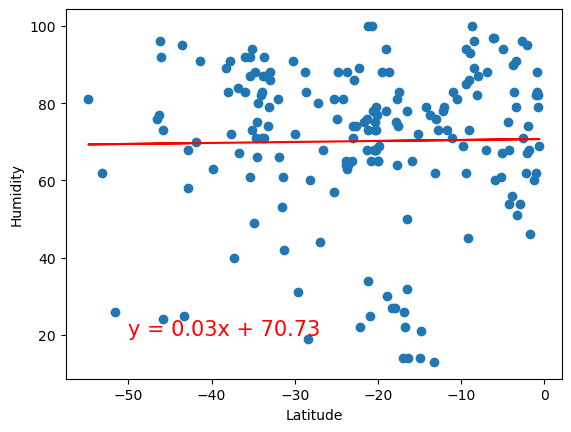

In [18]:
# Southern Hemisphere
# YOUR CODE HERE

**Discussion about the linear relationship:** YOUR RESPONSE HERE

### Cloudiness vs. Latitude Linear Regression Plot

The r-value is: 0.024026517125811015


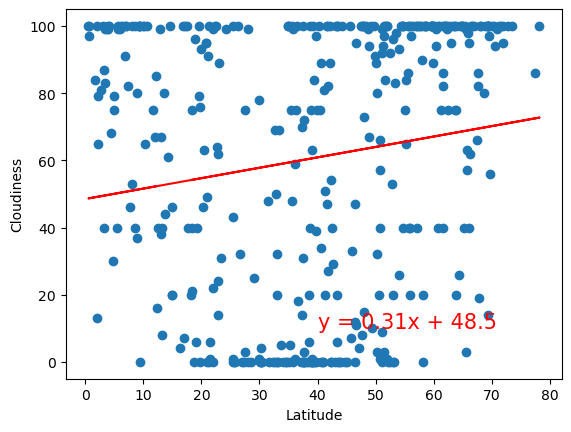

In [19]:
# Northern Hemisphere
# YOUR CODE HERE

The r-value is: 0.02056735429994368


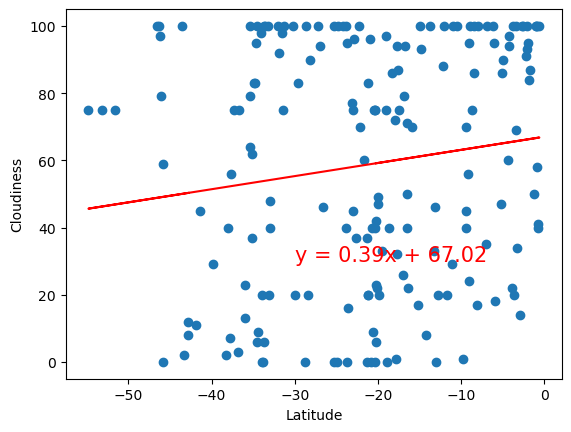

In [20]:
# Southern Hemisphere
# YOUR CODE HERE

**Discussion about the linear relationship:** YOUR RESPONSE HERE

### Wind Speed vs. Latitude Linear Regression Plot

The r-value is: 0.030396762354449467


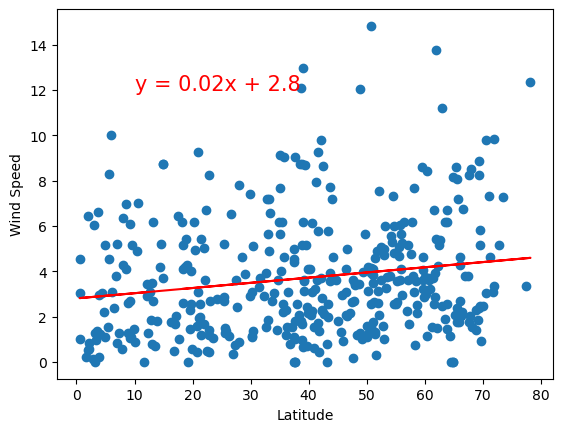

In [21]:
# Northern Hemisphere
# YOUR CODE HERE

The r-value is: 0.062239040700515696


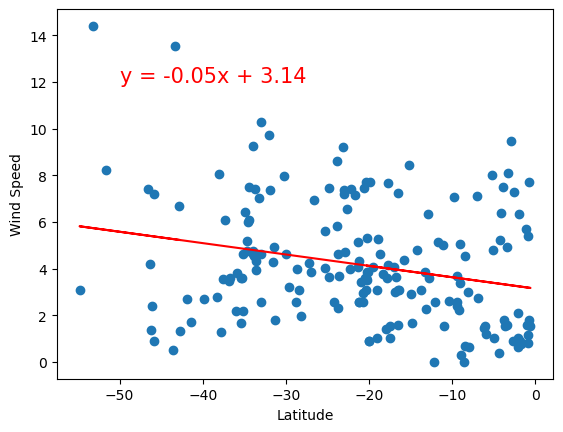

In [22]:
# Southern Hemisphere
# YOUR CODE HERE

**Discussion about the linear relationship:** YOUR RESPONSE HERE